In [1]:
from Datasets.ImageNetDataset import ImageNet100
from train_hae import load_hae_from_checkpoints

from torchvision import transforms

ROOT_FOLDER = '/home/dl_class/data/ILSVRC/Data/CLS-LOC/'

model = load_hae_from_checkpoints()
imageNet100 = ImageNet100(ROOT_FOLDER, split='val', transform=transforms.Compose([
                                                            transforms.CenterCrop(224),
                                                            transforms.ToTensor()]))

print(f'Loaded {len(model)} layer model')

Loaded 5 layer model


Layer 0 reconstructions


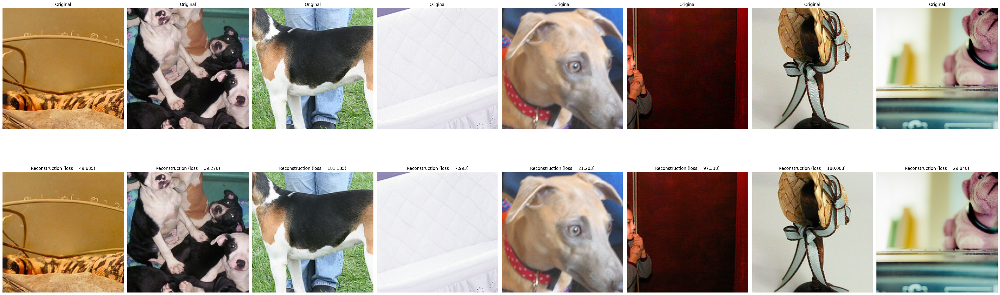

Layer 1 reconstructions


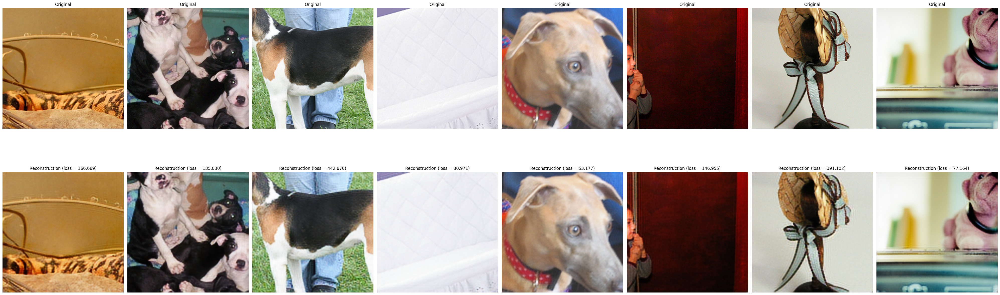

Layer 2 reconstructions


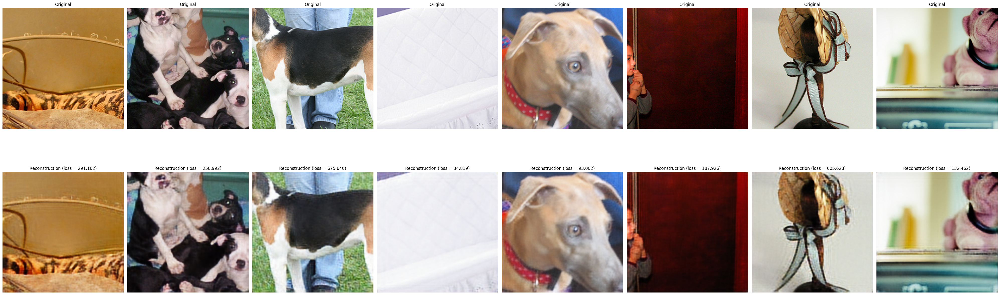

Layer 3 reconstructions


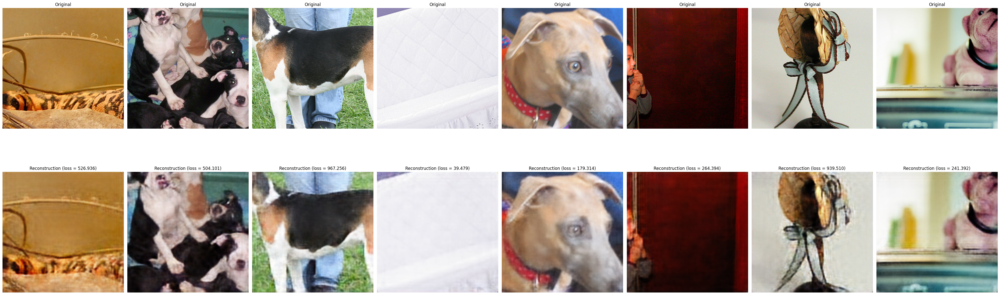

Layer 4 reconstructions


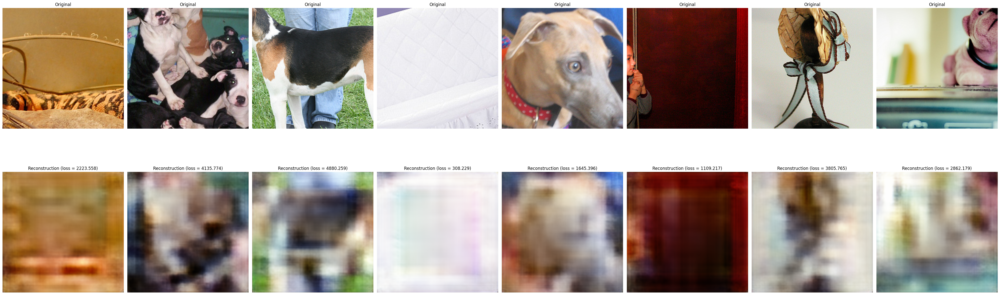

In [2]:
import matplotlib.pyplot as plt

for index, layer in enumerate(model):
    plt.figure(figsize=(40,15))
    print(f'Layer {index} reconstructions')
    for i in range(8):
        original, _ = imageNet100[i]
        original = original.unsqueeze(0)
        recon = layer.reconstruct(original)
        recon_loss = model.recon_loss(original, recon)

        recon = recon.squeeze()
        original = original.squeeze()

        plt.subplot(2, 8, i+1)
        plt.title("Original")
        plt.imshow(transforms.ToPILImage()(original))
        plt.axis('off')

        plt.subplot(2, 8, 9+i)
        plt.title(f"Reconstruction (loss = {recon_loss:.3f})")
        plt.imshow(transforms.ToPILImage()(recon))
        plt.axis('off')
    plt.tight_layout()
    plt.show()
